# Detección productos

In [13]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [14]:
import os
os.chdir('/content/drive/MyDrive/Universidad/Vision por computadores/ReconocimientoAlimentos_AlejandroVega_JoseMejia/src')

In [15]:
current_dir = os.getcwd()
print(current_dir)

/content/drive/MyDrive/Universidad/Vision por computadores/ReconocimientoAlimentos_AlejandroVega_JoseMejia/src


In [16]:
!pip install ultralytics

In [17]:
!nvidia-smi

Sun May 25 22:21:13 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   49C    P8             12W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [18]:
# Python function to automatically create data.yaml config file
# 1. Reads "classes.txt" file to get list of class names
# 2. Creates data dictionary with correct paths to folders, number of classes, and names of classes
# 3. Writes data in YAML format to data.yaml

import yaml
import os

def create_data_yaml(path_to_classes_txt, path_to_data_yaml):

  # Read class.txt to get class names
  if not os.path.exists(path_to_classes_txt):
    print(f'classes.txt file not found!')
    return
  with open(path_to_classes_txt, 'r') as f:
    classes = []
    for line in f.readlines():
      if len(line.strip()) == 0: continue
      classes.append(line.strip())
  number_of_classes = len(classes)

  # Create data dictionary
  data = {
      'path': '../data',
      'train': 'train/images',
      'val': 'validation/images',
      'nc': number_of_classes,
      'names': classes
  }

  # Write data to YAML file
  with open(path_to_data_yaml, 'w') as f:
    yaml.dump(data, f, sort_keys=False)
  print(f'Created config file at {path_to_data_yaml}')

  return

# Define path to classes.txt and run function
path_to_classes_txt = '../data/classes.txt'
path_to_data_yaml = '../src/data.yaml'

create_data_yaml(path_to_classes_txt, path_to_data_yaml)

Created config file at ../src/data.yaml


In [19]:
import shutil
train_dir = 'runs/detect/train'
if os.path.exists(train_dir):
    shutil.rmtree(train_dir)

In [20]:
!yolo detect train data=data.yaml model=yolo11s.pt epochs=80 imgsz=640

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
Ultralytics 8.3.144 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=80, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, l

In [21]:
import shutil
predict_dir = 'runs/detect/predict'
if os.path.exists(predict_dir):
    shutil.rmtree(predict_dir)

In [22]:
!yolo detect predict model=runs/detect/train/weights/best.pt source=../data/validation/images save=True

Ultralytics 8.3.144 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s summary (fused): 100 layers, 9,419,766 parameters, 0 gradients, 21.3 GFLOPs

image 1/36 /content/drive/MyDrive/Universidad/Vision por computadores/ReconocimientoAlimentos_AlejandroVega_JoseMejia/src/../data/validation/images/003c7719-IMG_5832.JPEG: 640x480 9 Arepas, 107.0ms
image 2/36 /content/drive/MyDrive/Universidad/Vision por computadores/ReconocimientoAlimentos_AlejandroVega_JoseMejia/src/../data/validation/images/0e243784-IMG_5895.JPEG: 640x480 5 Jugo de Mandarinas, 17.3ms
image 3/36 /content/drive/MyDrive/Universidad/Vision por computadores/ReconocimientoAlimentos_AlejandroVega_JoseMejia/src/../data/validation/images/0e900d86-BA65B34E-49CD-48D2-92C0-32B6C9CDD343.jpg: 640x384 5 Atuns, 2 Mermeladas, 81.5ms
image 4/36 /content/drive/MyDrive/Universidad/Vision por computadores/ReconocimientoAlimentos_AlejandroVega_JoseMejia/src/../data/validation/images/0fa7b49a-IMG_5814.JPEG: 640x480 10 BonYu

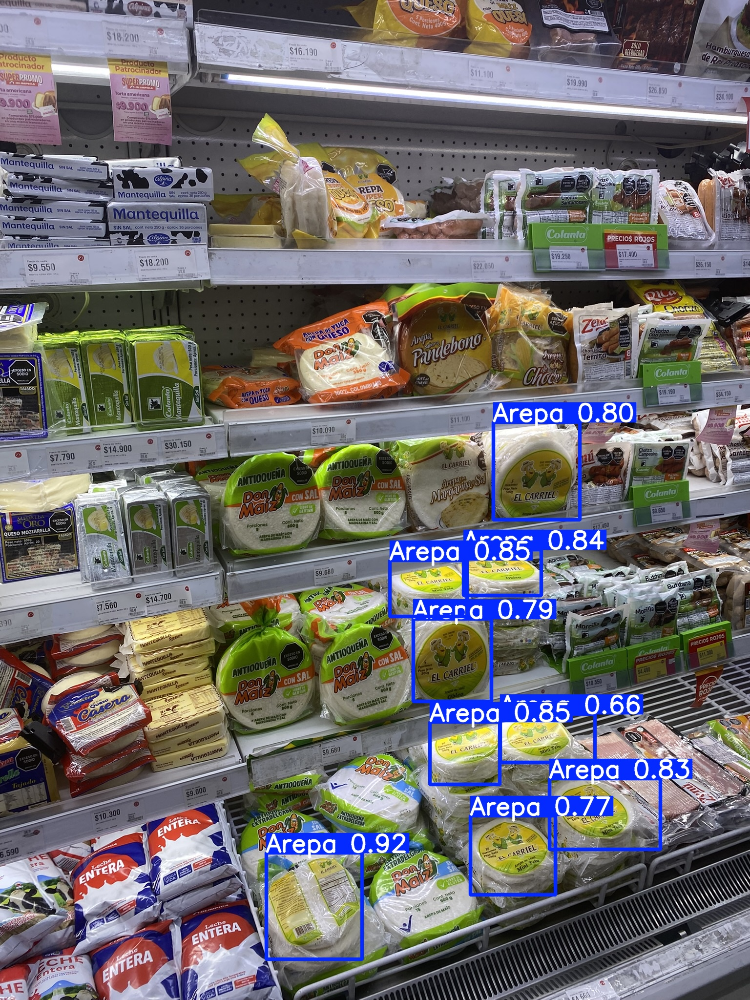

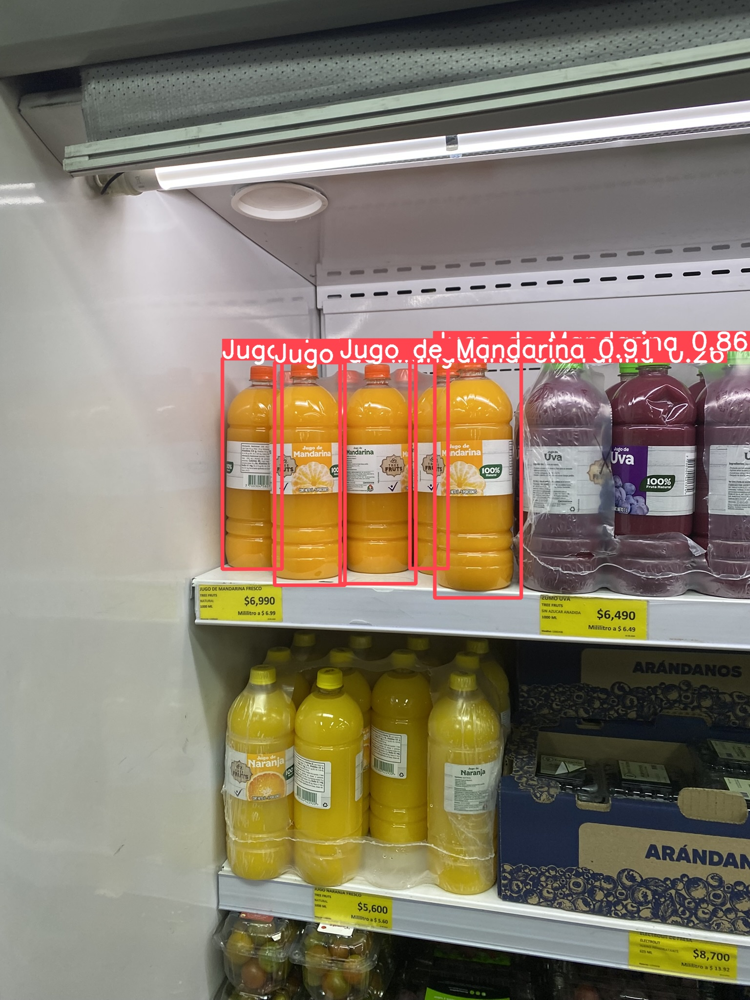

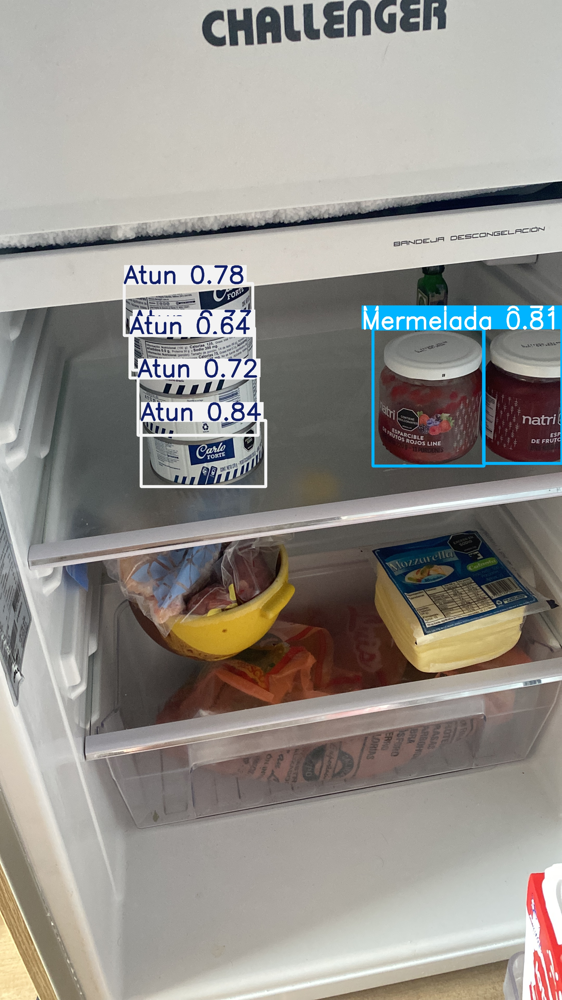

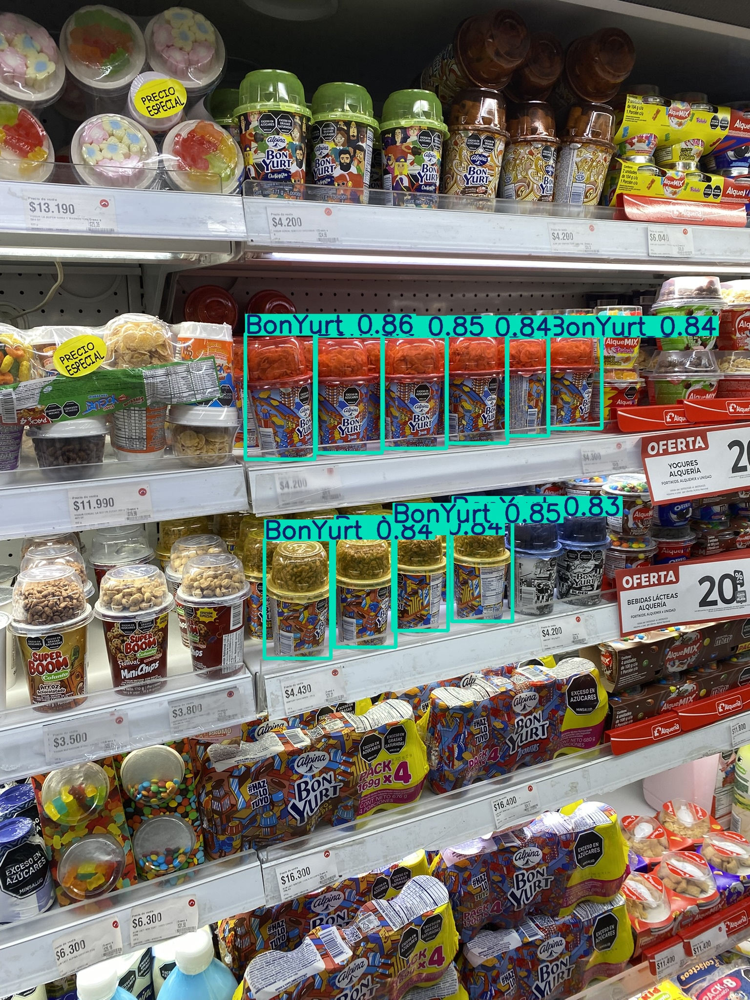

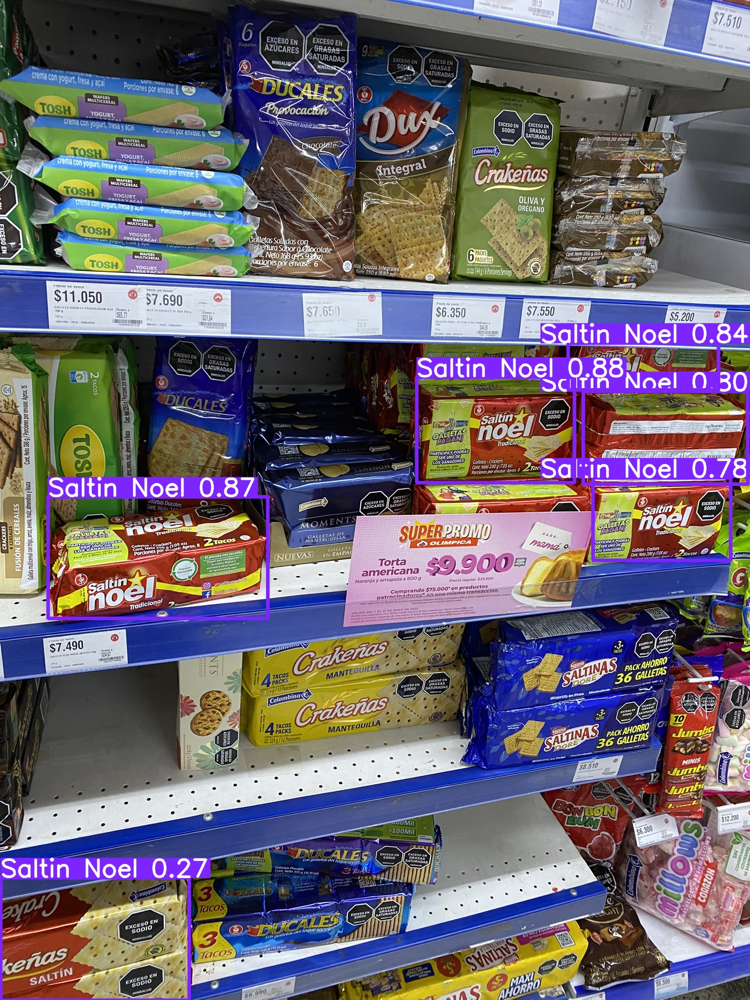

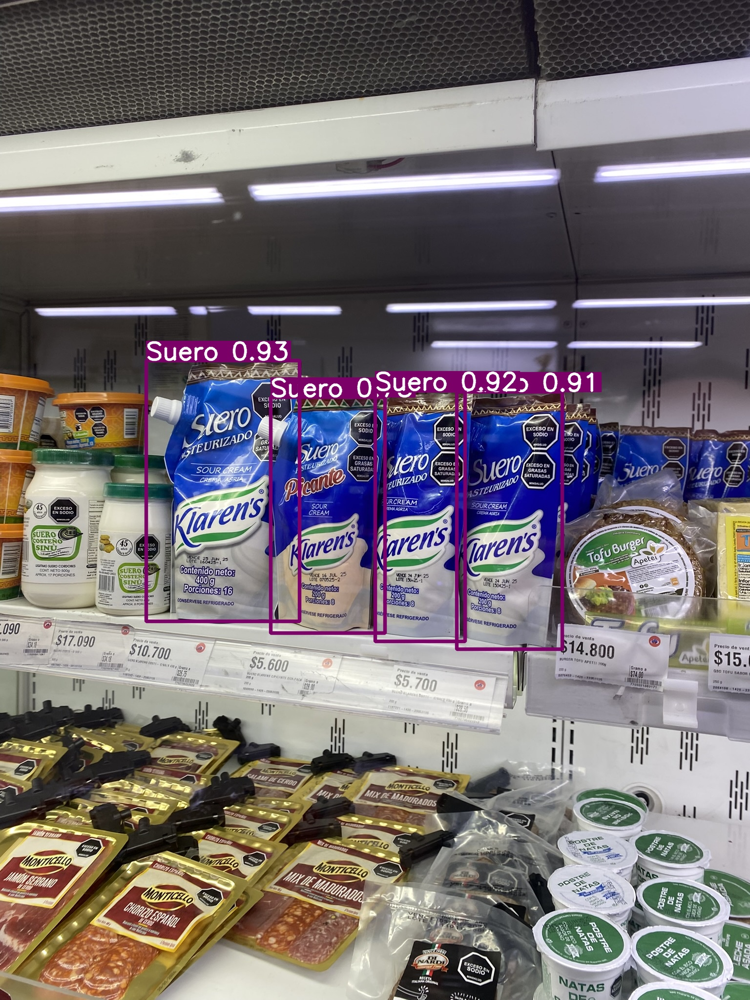

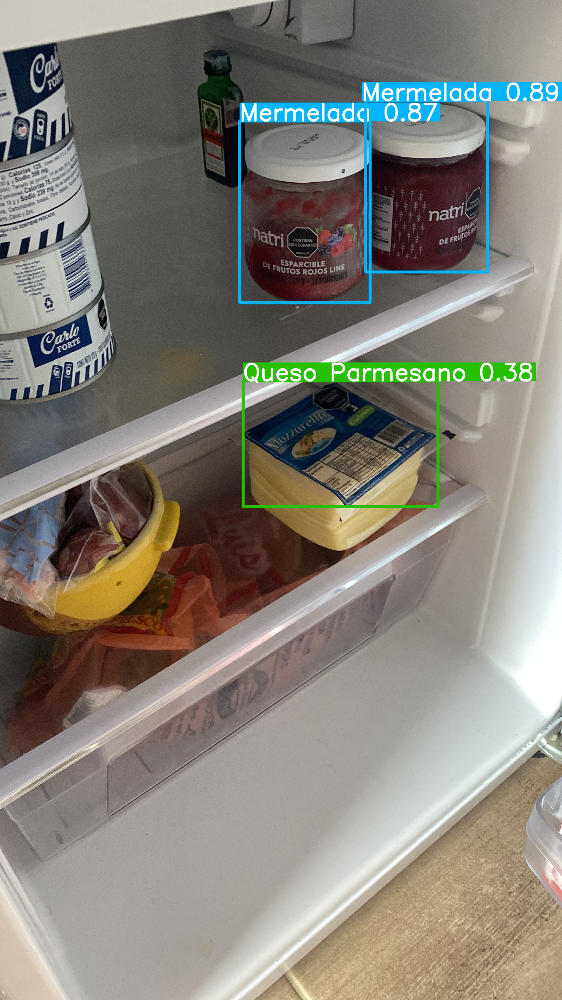

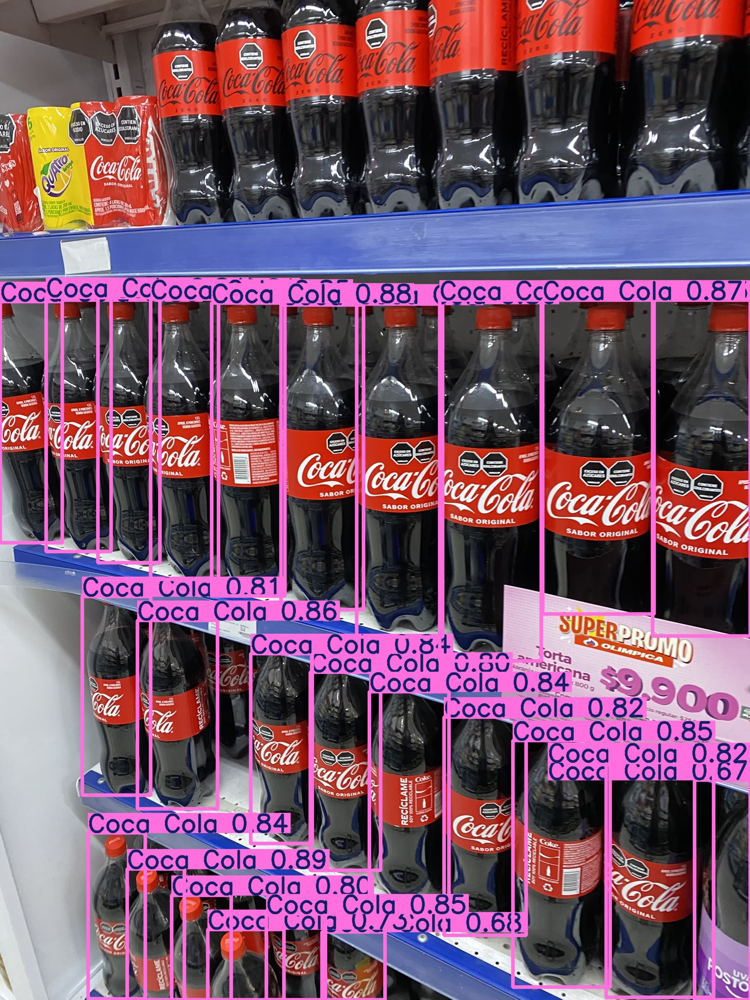

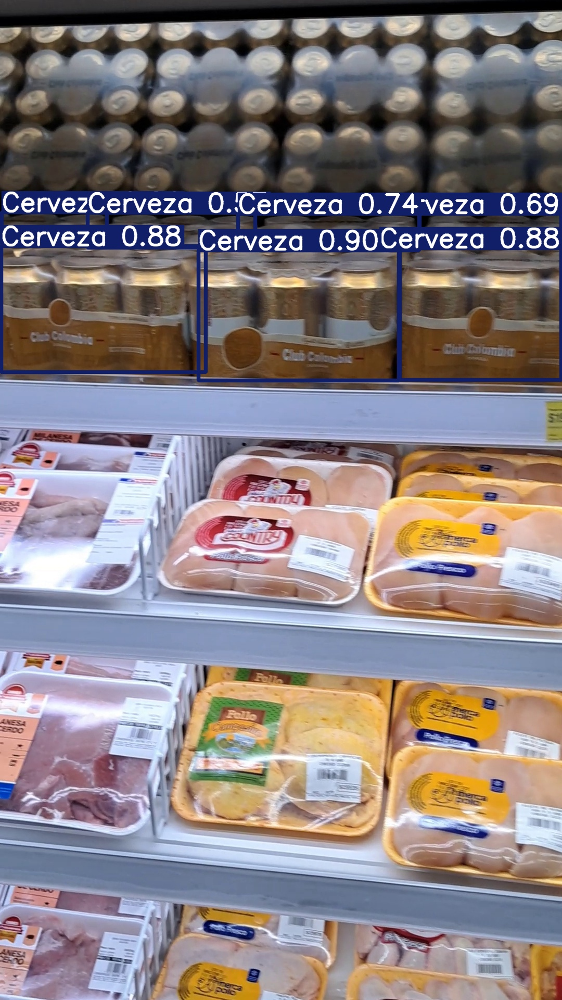

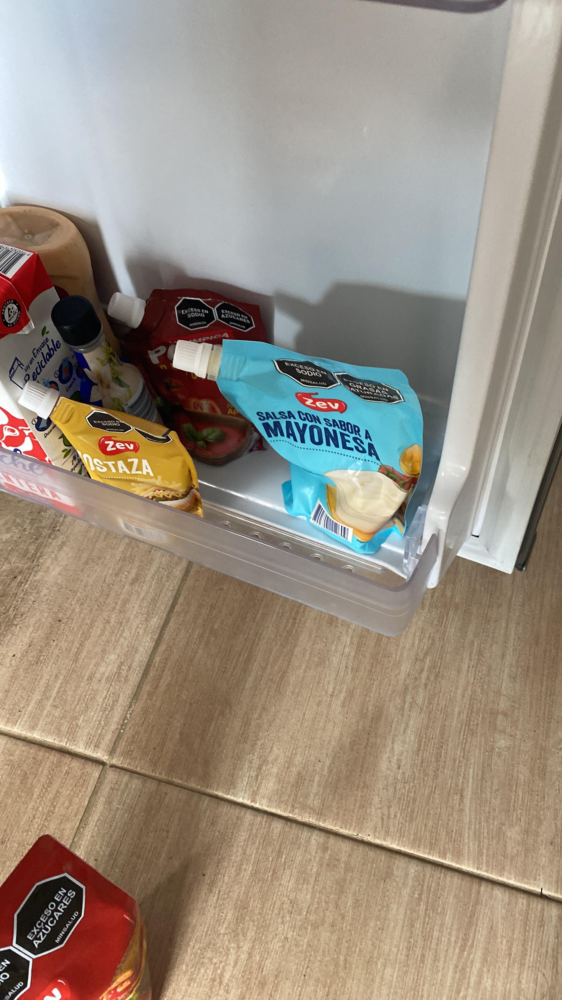

In [23]:
import glob
from IPython.display import Image, display
for image_path in glob.glob(f'runs/detect/predict/*.jpg')[:10]:
  display(Image(filename=image_path, height=400))
  print('\n')

In [24]:
import shutil
predict2_dir = 'runs/detect/predict2'
if os.path.exists(predict2_dir):
    shutil.rmtree(predict2_dir)

In [25]:
from ultralytics import YOLO

model = YOLO('runs/detect/train/weights/best.pt')
results = model.predict(
    source='IMG_5900_rotated.MP4',
    save=True,
    save_txt=True,
    save_conf=True
)


WARNING ⚠️ 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/407) /content/drive/MyDrive/Universidad/Vision por computadores/ReconocimientoAlimentos_AlejandroVega_JoseMejia/src/IMG_5900_rotated.MP4: 640x384 2 Mermeladas, 1 Queso Parmesano, 48.8ms
video 1/1 (frame 2/407) /content/drive/MyDrive/Universidad/Vision por computadores/ReconocimientoAlimentos_AlejandroVega_JoseMejia/src/IMG_5900_rotated.MP4: 640x384 2 Mermeladas, 10.7ms
video 1/1 (frame 3/407) /content/drive/MyDrive/Universidad/Vision

In [26]:
from moviepy.editor import *

path = 'runs/detect/predict2/IMG_5900_rotated.avi'

clip = VideoFileClip(path)
clip.ipython_display(width=280)

  if event.key is 'enter':



Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



t:  98%|█████████▊| 400/408 [00:07<00:00, 76.24it/s, now=None]WARNING:py.warnings:/usr/local/lib/python3.11/dist-packages/moviepy/video/io/ffmpeg_reader.py:123: UserWarning: Warning: in file runs/detect/predict2/IMG_5900_rotated.avi, 2764800 bytes wanted but 0 bytes read,at frame 407/408, at time 16.96/16.96 sec. Using the last valid frame instead.
  warnings.warn("Warning: in file %s, "%(self.filename)+



Moviepy - Done !
Moviepy - video ready __temp__.mp4


In [5]:
import torch
import torchvision.transforms as T
from PIL import Image
from torchvision import models
import numpy as np
import cv2

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
import os
os.chdir('/content/drive/MyDrive/Universidad/Vision por computadores/ReconocimientoAlimentos_AlejandroVega_JoseMejia/src')

In [16]:
# Se carga ResNet y se quita la últma capa de clasificación
model = models.resnet50(pretrained=True)
model = torch.nn.Sequential(*(list(model.children())[:-1]))
model.eval()

#torch.save(model.state_dict(), 'resnet50_feature_extractor.pth')

In [14]:
transform = T.Compose([
    T.Resize((224, 224)),
    T.ToTensor(),
    T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

def histogram_eq(image):
    # Convert any PIL Image to OpenCV format
    img = np.array(image)
    img = cv2.cvtColor(img, cv2.COLOR_RGB2YCrCb)
    # Equalize the Y (luminance) channel
    img[:,:,0] = cv2.equalizeHist(img[:,:,0])
    # Convert back to RGB
    img = cv2.cvtColor(img, cv2.COLOR_YCrCb2RGB)
    return Image.fromarray(img)

def get_features(img_path):
    img = Image.open(img_path).convert('RGB')
    img = histogram_eq(img)  # Apply histogram equalization
    x = transform(img).unsqueeze(0)
    with torch.no_grad():
        feats = model(x).squeeze().numpy().flatten()
    feats = feats / np.linalg.norm(feats)  # Normalize
    return feats

In [11]:
features_empty = get_features('../data/nevera_vacia.jpg')
features_full = get_features('../data/nevera_llena.jpg')

np.save('runs/embedding_vacio.npy', features_empty)
np.save('runs/embedding_lleno.npy', features_full)

features_test = get_features('../data/nevera_casivacia.jpg')

In [12]:
def cosine_similarity(a, b):
    return np.dot(a, b) / (np.linalg.norm(a) * np.linalg.norm(b))

sim_to_empty = cosine_similarity(features_test, features_empty)
sim_to_full = cosine_similarity(features_test, features_full)

# Se calculan distancias a lleno y vacío
distance_to_empty = 1 - sim_to_empty
distance_to_full = 1 - sim_to_full

# Se normaliza el score de que tal llena está la nevera
fullness_score = distance_to_empty / (distance_to_empty + distance_to_full)

fullness_percent = fullness_score * 100

print(f"Similaridad a vacía: {sim_to_empty}")
print(f"Similaridad a llena: {sim_to_full}")
print(f"La nevera está llena un {fullness_percent:.2f}%")

Similaridad a vacía: 0.9563032388687134
Similaridad a llena: 0.870054304599762
La nevera está llena un 25.16%
